# Download files if they don't exist

In [1]:
import requests
from bs4 import BeautifulSoup

downloadPage = requests.get("https://www.sec.gov/dera/data/form-d")
print(downloadPage.status_code)

downloadHTML = downloadPage.content

soup = BeautifulSoup(downloadHTML, 'html.parser')

200


In [2]:
from os import path, makedirs
import urllib
import zipfile

body = soup.find('body')

table = soup.find_all('table', { 'class': 'list' })[0]
tableBody = table.find_all('tr')

rawDataPath = "raw_data"
extractedPath = 'extracted'
if not path.exists(rawDataPath):
    makedirs(rawDataPath)
if not path.exists(extractedPath):
    makedirs(extractedPath)

secBaseUrl = 'https://www.sec.gov'

for tableRow in tableBody:
    a = tableRow.find_all('a')
    if len(a) != 0:
        yearQuerter = a[0].encode_contents().decode()
        print('Checking "{}"'.format(yearQuerter))
        zipName = rawDataPath + '/' + '{}_d.zip'.format(yearQuerter.replace(' ', '').lower())
        folderName = extractedPath + '/' + '{}_d'.format(yearQuerter.replace(' ', ''))
        # Check if the data has been downloaded
        if not path.exists(zipName):
            uri = a[0]['href']
            print("Downloading {}", uri)
            urllib.request.urlretrieve(secBaseUrl + uri, zipName)
        else:
            print('zip already exists')

        # Check if the data has been unzipped
        if not path.exists(folderName):
            print('extracting {}'.format(zipName))
            with zipfile.ZipFile(zipName, 'r') as zip_ref:
                zip_ref.extractall(extractedPath)
        else:
            print('already extracted {}'.format(zipName))

Checking "2022 Q1"
zip already exists
already extracted raw_data/2022q1_d.zip
Checking "2021 Q4"
zip already exists
already extracted raw_data/2021q4_d.zip
Checking "2021 Q3"
zip already exists
already extracted raw_data/2021q3_d.zip
Checking "2021 Q2"
zip already exists
already extracted raw_data/2021q2_d.zip
Checking "2021 Q1"
zip already exists
already extracted raw_data/2021q1_d.zip
Checking "2020 Q4"
zip already exists
already extracted raw_data/2020q4_d.zip
Checking "2020 Q3"
zip already exists
already extracted raw_data/2020q3_d.zip
Checking "2020 Q2"
zip already exists
already extracted raw_data/2020q2_d.zip
Checking "2020 Q1"
zip already exists
already extracted raw_data/2020q1_d.zip
Checking "2019 Q4"
zip already exists
already extracted raw_data/2019q4_d.zip
Checking "2019 Q3"
zip already exists
already extracted raw_data/2019q3_d.zip
Checking "2019 Q2"
zip already exists
already extracted raw_data/2019q2_d.zip
Checking "2019 Q1"
zip already exists
already extracted raw_data

## Load dataframe

In [3]:
from matplotlib import pyplot as plt
import matplotlib
import pandas as pd
from os import listdir
import plotly.express as px

# Set the figure size - handy for larger output
plt.rcParams["figure.figsize"] = [20, 12]
# Set up with a higher resolution screen (useful on Mac)
%config InlineBackend.figure_format = 'retina'
plt.style.use('dark_background')

df = pd.DataFrame()

extractedPath = 'extracted'

# Load data into memory
dirs = listdir(extractedPath)
rawDict = {}
for dir in dirs:
  if dir != ".DS_STORE":
    year = dir.split('Q')[0]
    quarter = dir.split('Q')[1].split('_')[0]
    # open the tsv and get rows
    newdat = pd.read_csv('extracted/' + dir + '/FORMDSUBMISSION.tsv', sep='\t')
    # set the quarter and year
    newdat['year'] = year
    newdat['quarter'] = quarter
    newdat['year quarter'] = year + ' Q' + quarter
    df = pd.concat([df, newdat])

In [4]:
print(df.shape, df.columns)
ttdf = df.groupby(['year quarter']).size().rename('num').reset_index()

(522530, 12) Index(['ACCESSIONNUMBER', 'FILE_NUM', 'FILING_DATE', 'SIC_CODE',
       'SCHEMAVERSION', 'SUBMISSIONTYPE', 'TESTORLIVE', 'OVER100PERSONSFLAG',
       'OVER100ISSUERFLAG', 'year', 'quarter', 'year quarter'],
      dtype='object')


# Perform Analysis

### Time series of filings, By Quarter Year

In [5]:
# plot = df.groupby(['year quarter']).size().plot()
# plot.set_ylabel('Filings')
# plot.set_xlabel('Quarter')
print(ttdf)
fig = px.line(ttdf, x='year quarter', y="num", title="Number of Form D submissions per quarter", labels={
  "num": "Number of filings",
  'year quarter': 'Quarter'
},  template='plotly_dark')
fig.update_xaxes(
  tickvals=['2008 Q1', '2009 Q1', '2010 Q1', '2011 Q1', '2012 Q1', '2013 Q1', '2014 Q1', '2015 Q1', '2016 Q1', '2017 Q1', '2018 Q1', '2019 Q1', '2020 Q1', '2021 Q1', '2022 Q1']
)
fig.write_html('num_filings_per_quarter.html')
fig.show()

   year quarter    num
0       2008 Q1      1
1       2008 Q2      1
2       2008 Q3     31
3       2008 Q4    409
4       2009 Q1   4113
5       2009 Q2   5254
6       2009 Q3   5756
7       2009 Q4   5720
8       2010 Q1  10524
9       2010 Q2   6449
10      2010 Q3   6100
11      2010 Q4   6374
12      2011 Q1  10510
13      2011 Q2   6892
14      2011 Q3   6708
15      2011 Q4   6601
16      2012 Q1  10503
17      2012 Q2   7510
18      2012 Q3   6610
19      2012 Q4   6847
20      2013 Q1  10653
21      2013 Q2   7700
22      2013 Q3   7721
23      2013 Q4   8309
24      2014 Q1  11259
25      2014 Q2   8971
26      2014 Q3   8680
27      2014 Q4   9074
28      2015 Q1  11436
29      2015 Q2   9371
30      2015 Q3   9036
31      2015 Q4   9123
32      2016 Q1  11764
33      2016 Q2   9625
34      2016 Q3   9084
35      2016 Q4   9313
36      2017 Q1  12065
37      2017 Q2  10269
38      2017 Q3   9667
39      2017 Q4   9940
40      2018 Q1  12542
41      2018 Q2  10928
42      201

Notably over tha last decade Q1 has been very popular for filings, and otherwise has been relatively flat. Come 2021 the numbers keep climbing!

In [6]:
# Number of rows by year and quarter
print(df.groupby(['year', 'quarter']).size())

year  quarter
2008  1              1
      2              1
      3             31
      4            409
2009  1           4113
      2           5254
      3           5756
      4           5720
2010  1          10524
      2           6449
      3           6100
      4           6374
2011  1          10510
      2           6892
      3           6708
      4           6601
2012  1          10503
      2           7510
      3           6610
      4           6847
2013  1          10653
      2           7700
      3           7721
      4           8309
2014  1          11259
      2           8971
      3           8680
      4           9074
2015  1          11436
      2           9371
      3           9036
      4           9123
2016  1          11764
      2           9625
      3           9084
      4           9313
2017  1          12065
      2          10269
      3           9667
      4           9940
2018  1          12542
      2          10928
      3          104

In [7]:
# only 4 quarters and not 2008
s = df.groupby(['year'])['quarter'].nunique()
quarterCount = s.where(s == 4).where(s.index != '2008').dropna()
print(quarterCount)

year
2009    4.0
2010    4.0
2011    4.0
2012    4.0
2013    4.0
2014    4.0
2015    4.0
2016    4.0
2017    4.0
2018    4.0
2019    4.0
2020    4.0
2021    4.0
Name: quarter, dtype: float64


In [8]:
# merge the results back together
qdf = quarterCount.rename('quarter_count')
mergedDF = pd.merge(df, qdf, 'left', 'year')
print(mergedDF[mergedDF['quarter_count'].notna()].sort_values(['year', 'quarter']).head(10))

             ACCESSIONNUMBER                   FILE_NUM          FILING_DATE  \
486460  0000919574-09-008068  021-129337                 2009-03-31 17:22:50   
486461  0001415725-09-000004  021-110008                 2009-03-31 17:22:44   
486462  0001460194-09-000001  021-129332                 2009-03-31 17:14:55   
486463  0001426379-09-000004  021-114399                 2009-03-31 17:13:50   
486464  0001169232-09-001783  021-127207                 2009-03-31 17:11:22   
486465  0001363176-09-000004  021-89848                  2009-03-31 17:05:43   
486466  0001460420-09-000001  021-129330                 2009-03-31 16:48:23   
486467  0001458021-09-000001  021-79913                  2009-03-31 16:46:29   
486468  0001431432-09-000002  021-116662                 2009-03-31 16:40:44   
486469  0001252458-09-000004  021-94827-9L               2009-03-31 16:40:10   

        SIC_CODE SCHEMAVERSION SUBMISSIONTYPE TESTORLIVE OVER100PERSONSFLAG  \
486460       NaN         X0301          

In [9]:
cleaned = mergedDF[mergedDF['quarter_count'].notna()]

In [10]:
uniqueFilings = cleaned.groupby(['ACCESSIONNUMBER', 'FILE_NUM']).count()

## Fetch filing XML

In [11]:
import pandas as pd
issuersdf = pd.DataFrame()

# Load data into memory
dirs = listdir(extractedPath)
rawDict = {}
for dir in dirs:
  year = dir.split('Q')[0]
  quarter = dir.split('Q')[1].split('_')[0]
  # open the tsv and get rows
  newdat = pd.read_csv('extracted/' + dir + '/ISSUERS.tsv', sep='\t')
  # set the quarter and year
  newdat['year'] = year
  newdat['quarter'] = quarter
  issuersdf = pd.concat([issuersdf, newdat])

In [12]:
# only 4 quarters and not 2008
s = issuersdf.groupby(['year'])['quarter'].nunique()
quarterCount = s.where(s == 4).where(s.index != '2008').dropna()

# merge results back together
qdf = quarterCount.rename('quarter_count')
mergedDF = pd.merge(issuersdf, qdf, 'left', 'year')

In [13]:
cleaned = mergedDF[mergedDF['quarter_count'].notna()]

In [14]:
print(cleaned.columns)

Index(['ACCESSIONNUMBER', 'IS_PRIMARYISSUER_FLAG', 'ISSUER_SEQ_KEY', 'CIK',
       'ENTITYNAME', 'STREET1', 'STREET2', 'CITY', 'STATEORCOUNTRY',
       'STATEORCOUNTRYDESCRIPTION', 'ZIPCODE', 'ISSUERPHONENUMBER',
       'JURISDICTIONOFINC', 'ISSUER_PREVIOUSNAME_1', 'ISSUER_PREVIOUSNAME_2',
       'ISSUER_PREVIOUSNAME_3', 'EDGAR_PREVIOUSNAME_1', 'EDGAR_PREVIOUSNAME_2',
       'EDGAR_PREVIOUSNAME_3', 'ENTITYTYPE', 'ENTITYTYPEOTHERDESC',
       'YEAROFINC_TIMESPAN_CHOICE', 'YEAROFINC_VALUE_ENTERED', 'year',
       'quarter', 'quarter_count'],
      dtype='object')


In [15]:
filings = cleaned.groupby(['CIK', 'ACCESSIONNUMBER'], as_index=False).count()

In [16]:
# Download the filing XML
print(filings)
templateString = 'https://www.sec.gov/Archives/edgar/data/{}/{}/primary_doc.xml'
print(filings.columns)
cik = filings.at[0, 'CIK']
an = filings.at[0, 'ACCESSIONNUMBER']
firstURL = templateString.format(cik, an.replace('-', ''))
print(firstURL)

import urllib.request

opener = urllib.request.build_opener()
opener.addheaders = [
  ('User-agent', 'Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/100.0.4896.75 Safari/537.36'),
  ('accept', 'text/html,application/xhtml+xml,application/xml;q=0.9,image/avif,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9'),
  ('cookie', 'ak_bmsc=13AFC76A76B428109003A783CBC4DA2A~000000000000000000000000000000~YAAQn3hGaCTK+wGAAQAAOBROHw9lURiTkjBcpUaLWGw+LspxzV7hZDRhQiiOwyed4MBevQGw2H3WN/84eOMXc7cpxn4ks6MlQDOgHZTPHf5ymP5gdwWCyyXOJ0w46i+yjvdAZOaqdkUboI7+k3RW93891jFBlpIunHSL462f9O563RVvPBp0Uo0X3YMWDLeOYU1N1DphTCdJrl7K9gW4NloenM7vMYA+qExhz1rC6sdzgWive9yywpNbHBFJgCfwuCFgzU60DiI1yFoG+D1dWcdIYsjqBphzwggbMz1VLVEpjAzZQ8TDmtJ/WoF6/1KPHx4Yk4yrchrkVQCJxQpY179J6kfR8zX0cGOA+kAbgZ+ccjg3sfAJSClLQ7ClbD5a8MCN2TYbF2ZrQWBVDeMQlpQcTG5+MYdgJ/+V5X+t5G5WoZnW1o88PxNmG8FXbBtkF1Xdog4XA3YyBearPR4eOmEp7aVduKNqAwh3; bm_mi=BE7AE9627F13D1C5705D6E7F02B5124A~JeMMrZudNNcUzb/7umygbgc/KZvksH2wIreOBtzD4hfVfkOi8nKiWe5rwEYGY9UD1HZj+TBgXusWMUA9+u33I81+j6GNwsWiGQHsZExDwbnwhXQNpu9zbE0dOPzLIFzXRLPYHDBFRBmZ5U3PFv9ABHrayiGKIsdXOzNglpJiMHYeWzO6H91QMORv9PRLFh2YtAVBi0GMaluss7WHwRs4VQs7Ugwvny/cgVyUVpiDKKdgUpYdDN4/GOVMF8bN/s4OpOlr9utf+7L1Uc6l4d1+2DJ4s99y+/QB0hKbS5UsmX5EQ67AgpQ+6L/2GUWGkt7FQOg7wlkg4hNWfjNbc97CGjrkJUn2Wx+jXOvHDNDrTaayQFyAozfmNPXCSInqUcwX; bm_sv=004FF0E8914FAF1F7ACE7CDCA80DEE68~FYAPtTjKlWbI7DqywPHzTW76bQXL9vKiOUfaKdA3zuz7CjitLK1mfDMbftTEF95dypryZnDQdq3w3NltkNVDC9XtQUJUjjJT4TD4lQvPOX/EXJKWbbr5SjPJakTSvigREkxr6yBJCwBNRqnG8rymXQ=='),
  ('accept-language', 'en-US,en;q=0.9')
]
urllib.request.install_opener(opener)

urllib.request.urlretrieve(firstURL, 'filing_{}_{}.xml'.format(cik, an))

            CIK       ACCESSIONNUMBER  IS_PRIMARYISSUER_FLAG  ISSUER_SEQ_KEY  \
0          1800  0001104659-09-017676                      1               1   
1          1800  0001104659-10-014032                      1               1   
2          1800  0001104659-11-014429                      1               1   
3          1961  0001264931-13-000063                      1               1   
4          2381  0001465818-11-000005                      1               1   
...         ...                   ...                    ...             ...   
510011  1902265  0001376474-21-000475                      1               1   
510012  1902276  0001902276-21-000001                      1               1   
510013  1902284  0001902284-21-000001                      1               1   
510014  1902289  0001902289-21-000001                      1               1   
510015  1902291  0001902291-21-000001                      1               1   

        ENTITYNAME  STREET1  STREET2  C

('filing_1800_0001104659-09-017676.xml',
 <http.client.HTTPMessage at 0x15ce12af0>)

### Offerings

In [17]:
offerings = pd.DataFrame()

# Load data into memory
dirs = listdir(extractedPath)
rawDict = {}
for dir in dirs:
  year = dir.split('Q')[0]
  quarter = dir.split('Q')[1].split('_')[0]
  # open the tsv and get rows
  newdat = pd.read_csv('extracted/' + dir + '/OFFERING.tsv', sep='\t')
  # set the quarter and year
  newdat['year'] = year
  newdat['quarter'] = quarter
  offerings = pd.concat([offerings, newdat])

/usr/local/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning:

Columns (17,18) have mixed types.Specify dtype option on import or set low_memory=False.



In [18]:
print(offerings.columns)

Index(['ACCESSIONNUMBER', 'INDUSTRYGROUPTYPE', 'INVESTMENTFUNDTYPE', 'IS40ACT',
       'REVENUERANGE', 'AGGREGATENETASSETVALUERANGE',
       'FEDERALEXEMPTIONS_ITEMS_LIST', 'ISAMENDMENT',
       'PREVIOUSACCESSIONNUMBER', 'SALE_DATE', 'YETTOOCCUR', 'MORETHANONEYEAR',
       'ISEQUITYTYPE', 'ISDEBTTYPE', 'ISOPTIONTOACQUIRETYPE',
       'ISSECURITYTOBEACQUIREDTYPE', 'ISPOOLEDINVESTMENTFUNDTYPE',
       'ISTENANTINCOMMONTYPE', 'ISMINERALPROPERTYTYPE', 'ISOTHERTYPE',
       'DESCRIPTIONOFOTHERTYPE', 'ISBUSINESSCOMBINATIONTRANS',
       'BUSCOMBCLARIFICATIONOFRESP', 'MINIMUMINVESTMENTACCEPTED',
       'OVER100RECIPIENTFLAG', 'TOTALOFFERINGAMOUNT', 'TOTALAMOUNTSOLD',
       'TOTALREMAINING', 'SALESAMTCLARIFICATIONOFRESP',
       'HASNONACCREDITEDINVESTORS', 'NUMBERNONACCREDITEDINVESTORS',
       'TOTALNUMBERALREADYINVESTED', 'SALESCOMM_DOLLARAMOUNT',
       'SALESCOMM_ISESTIMATE', 'FINDERSFEE_DOLLARAMOUNT',
       'FINDERSFEE_ISESTIMATE', 'FINDERFEECLARIFICATIONOFRESP',
       'GROSSPROCEEDS

In [19]:
# only 4 quarters and not 2008
s = offerings.groupby(['year'])['quarter'].nunique()
quarterCount = s.where(s == 4).where(s.index != '2008').dropna()

# merge results back together
qdf = quarterCount.rename('quarter_count')
mergedDF = pd.merge(offerings, qdf, 'left', 'year')
cleaned = mergedDF[mergedDF['quarter_count'].notna()]

In [20]:
print(cleaned.sort_values(['year', 'quarter']).head(1))

             ACCESSIONNUMBER       INDUSTRYGROUPTYPE INVESTMENTFUNDTYPE  \
486460  0000919574-09-008068  Pooled Investment Fund         Hedge Fund   

       IS40ACT REVENUERANGE AGGREGATENETASSETVALUERANGE  \
486460   False          NaN         Decline to Disclose   

       FEDERALEXEMPTIONS_ITEMS_LIST  ISAMENDMENT PREVIOUSACCESSIONNUMBER  \
486460                 06, 3C, 3C.7        False                     NaN   

         SALE_DATE  ... FINDERSFEE_DOLLARAMOUNT  FINDERSFEE_ISESTIMATE  \
486460  2008-12-01  ...                       0                    NaN   

       FINDERFEECLARIFICATIONOFRESP GROSSPROCEEDSUSED_DOLLARAMOUNT  \
486460                          NaN                              0   

       GROSSPROCEEDSUSED_ISESTIMATE  \
486460                         True   

                             GROSSPROCEEDSUSED_CLAROFRESP  \
486460  The general partner is entitled to receive an ...   

       AUTHORIZEDREPRESENTATIVE  year quarter quarter_count  
486460                 

In [21]:
gbQuarter = cleaned.groupby(['quarter'])
print(gbQuarter.size().head(10))

quarter
1    145194
2    119965
3    116413
4    121958
dtype: int64


Text(0.5, 0, 'Quarter')

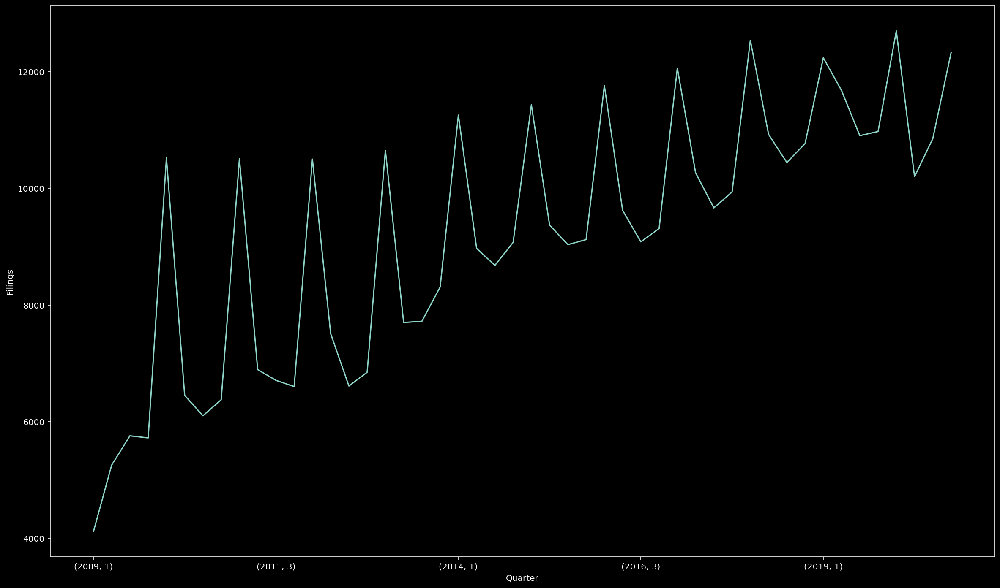

In [22]:
plot = offerings.where(offerings['year'] > '2008').where(offerings['year'] < '2021').groupby(['year', 'quarter']).size().plot()
plot.set_ylabel('Filings')
plot.set_xlabel('Quarter')

Let's look at percentage that Q1 represents by year

2009
   index  year quarter  filings      perc
0      0  2009       1     4113  0.197332
1      1  2009       2     5254  0.252075
2      2  2009       3     5756  0.276160
3      3  2009       4     5720  0.274433
2010
   index  year quarter  filings      perc
0      4  2010       1    10524  0.357388
1      5  2010       2     6449  0.219004
2      6  2010       3     6100  0.207152
3      7  2010       4     6374  0.216457
2011
   index  year quarter  filings      perc
0      8  2011       1    10510  0.342223
1      9  2011       2     6892  0.224415
2     10  2011       3     6708  0.218423
3     11  2011       4     6601  0.214939
2012
   index  year quarter  filings      perc
0     12  2012       1    10503  0.333746
1     13  2012       2     7510  0.238640
2     14  2012       3     6610  0.210041
3     15  2012       4     6847  0.217572
2013
   index  year quarter  filings      perc
0     16  2013       1    10653  0.309833
1     17  2013       2     7700  0.223948
2     18 

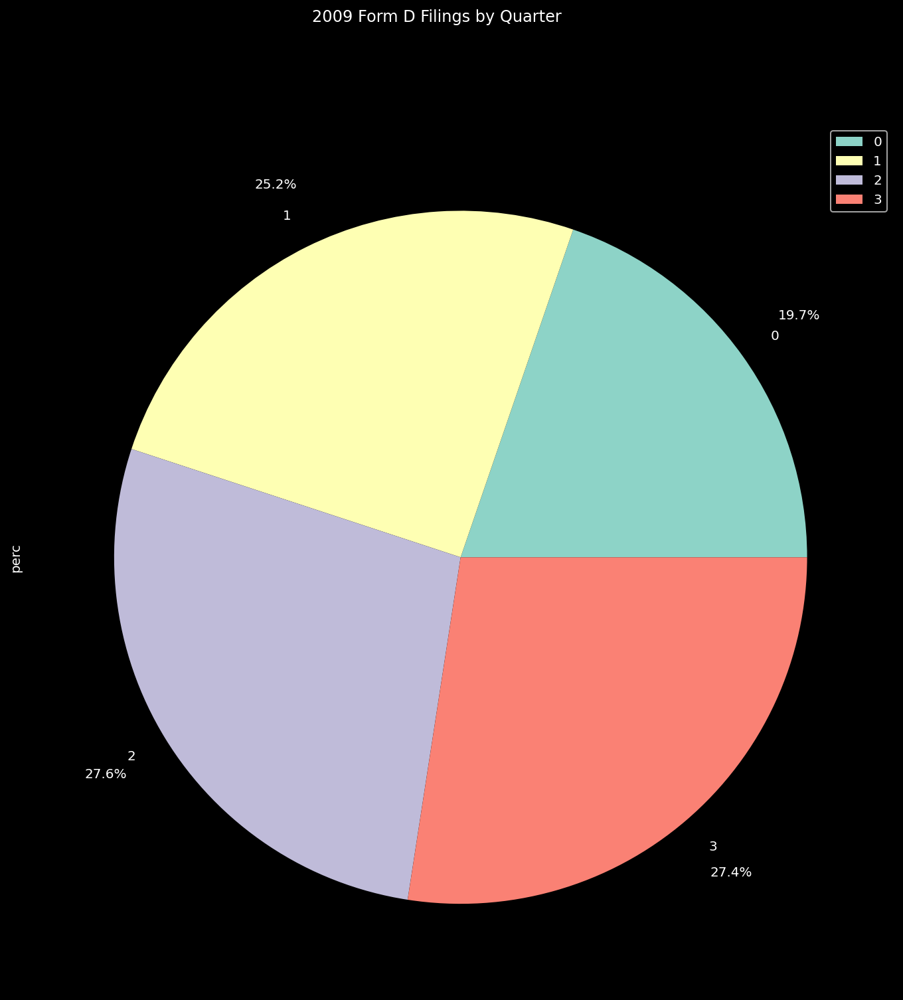

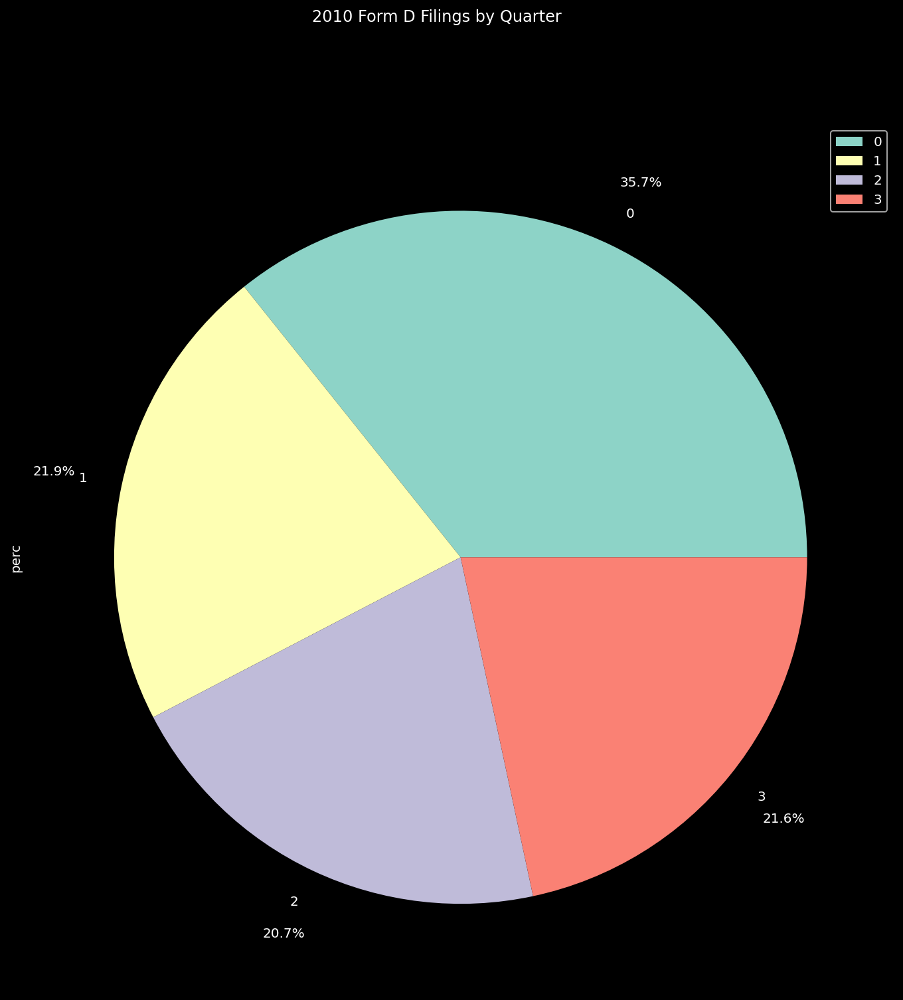

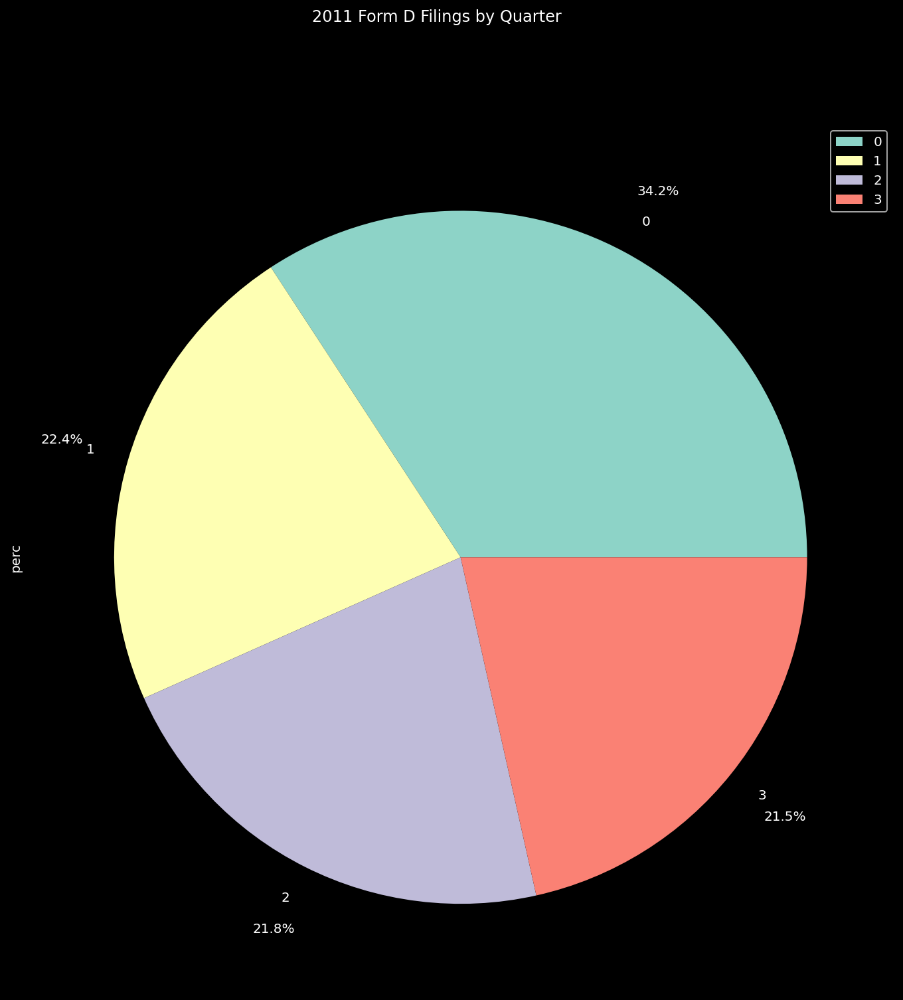

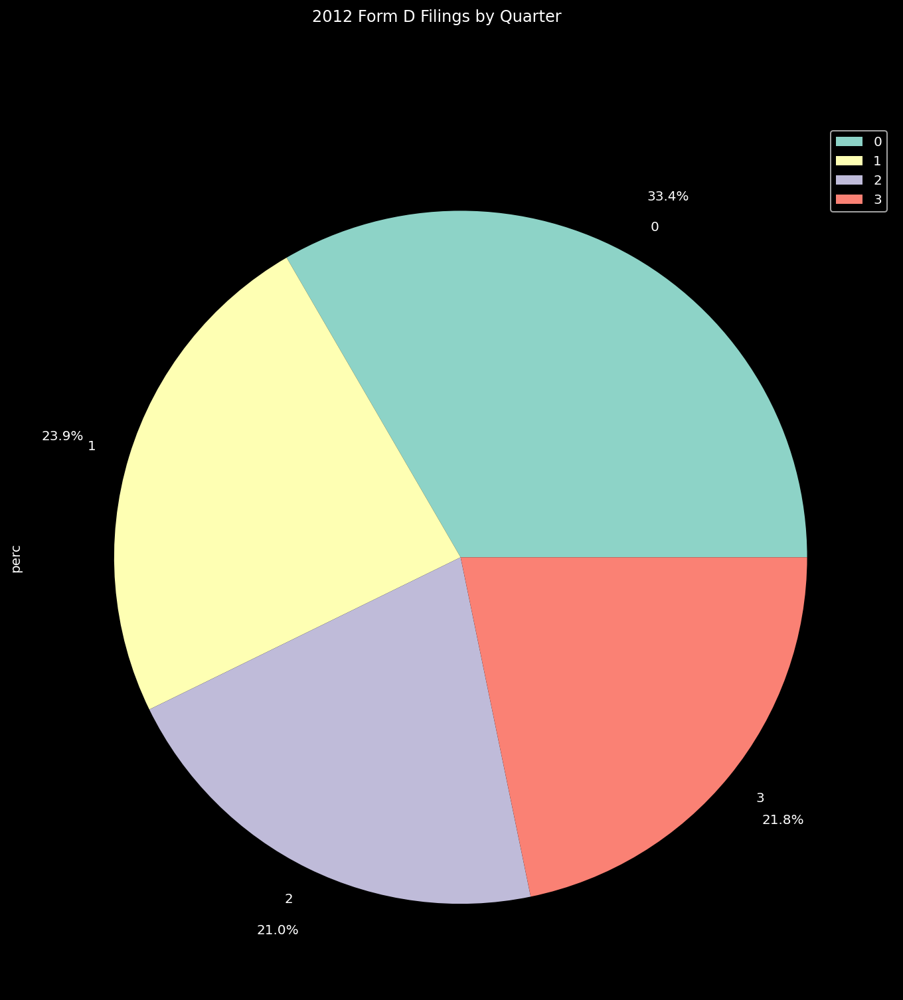

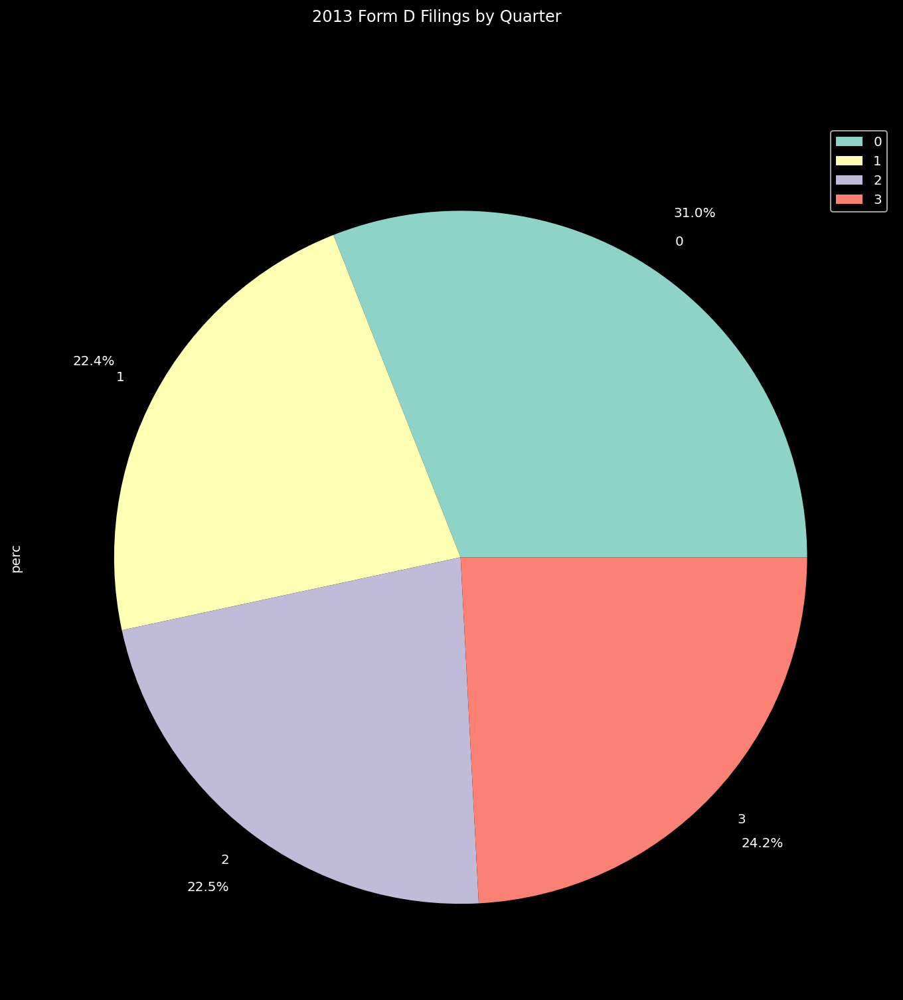

...

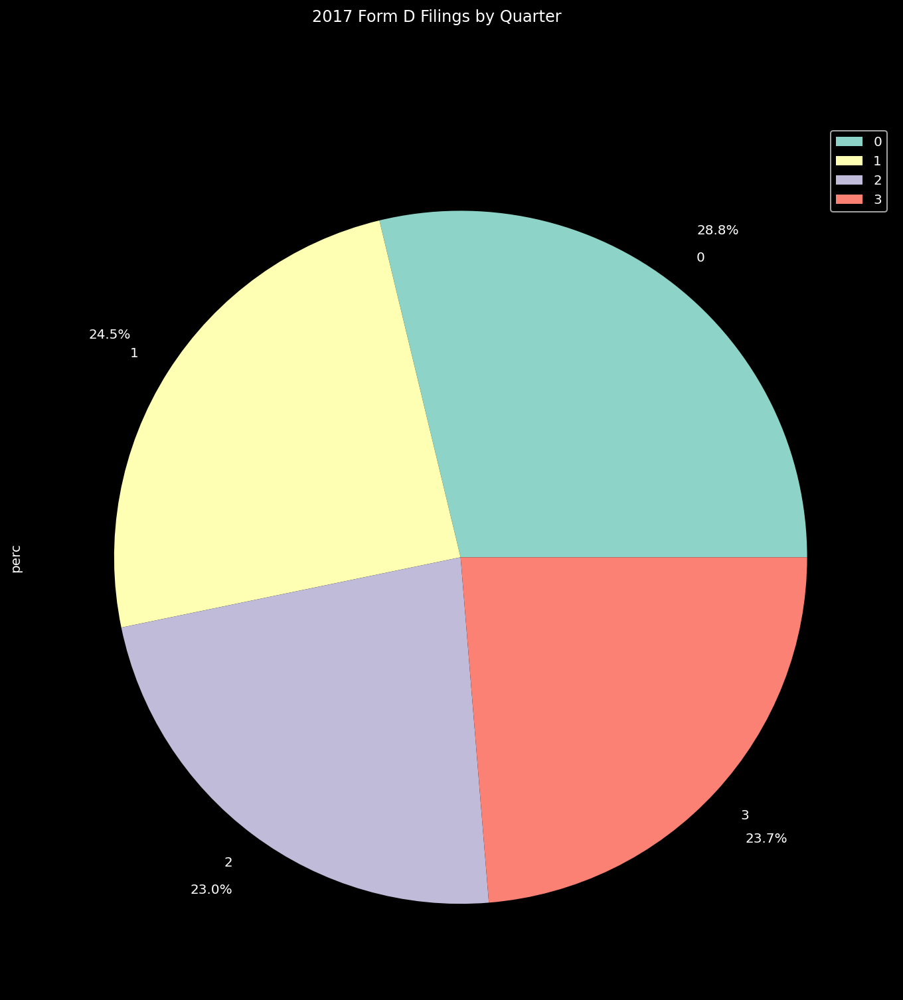

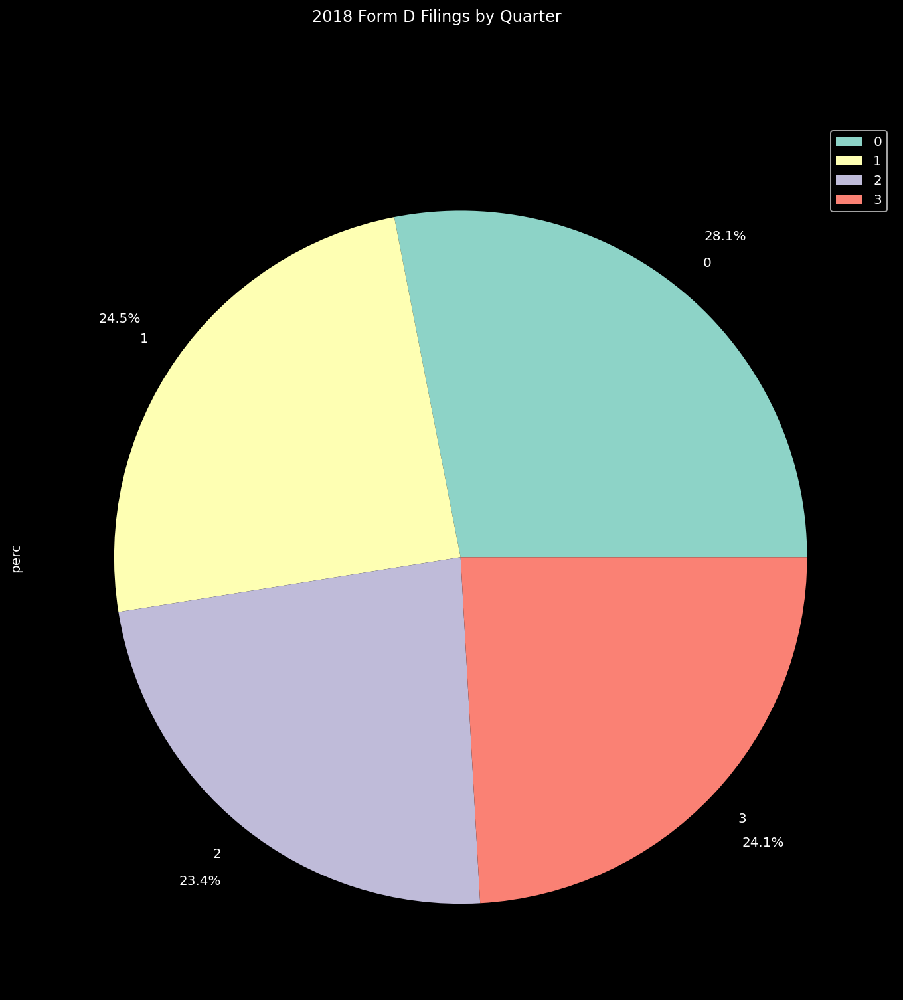

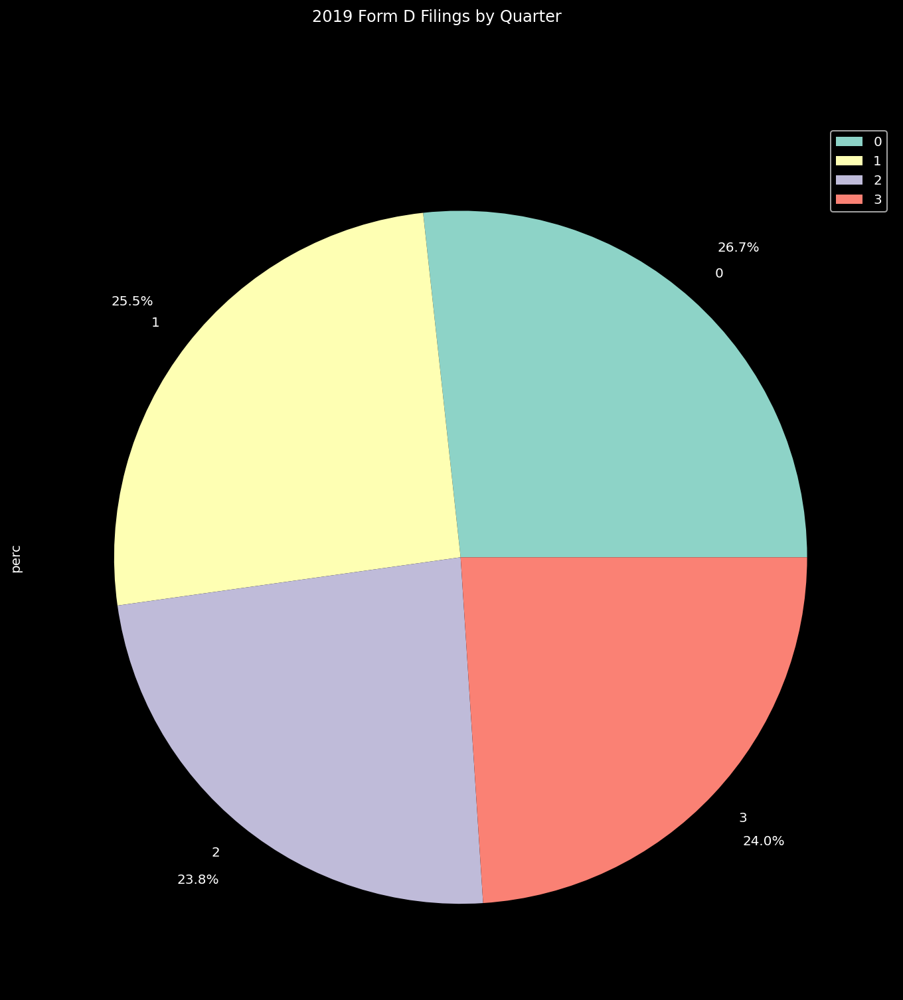

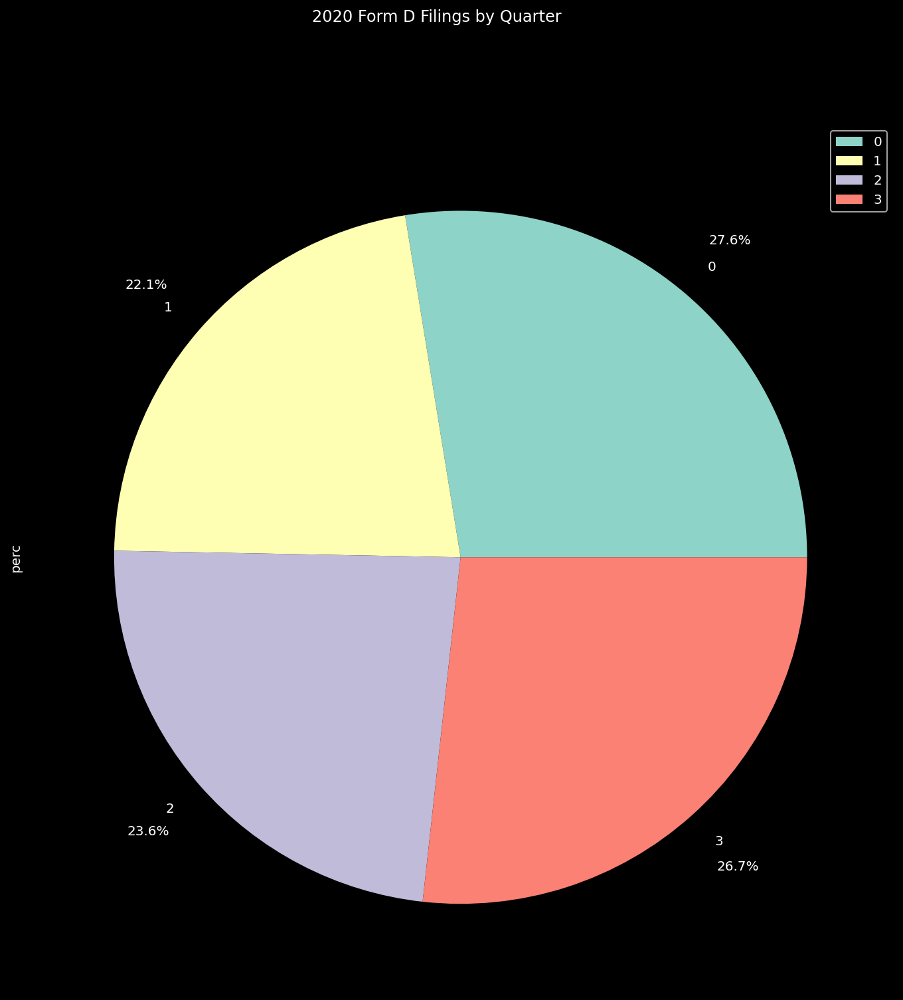

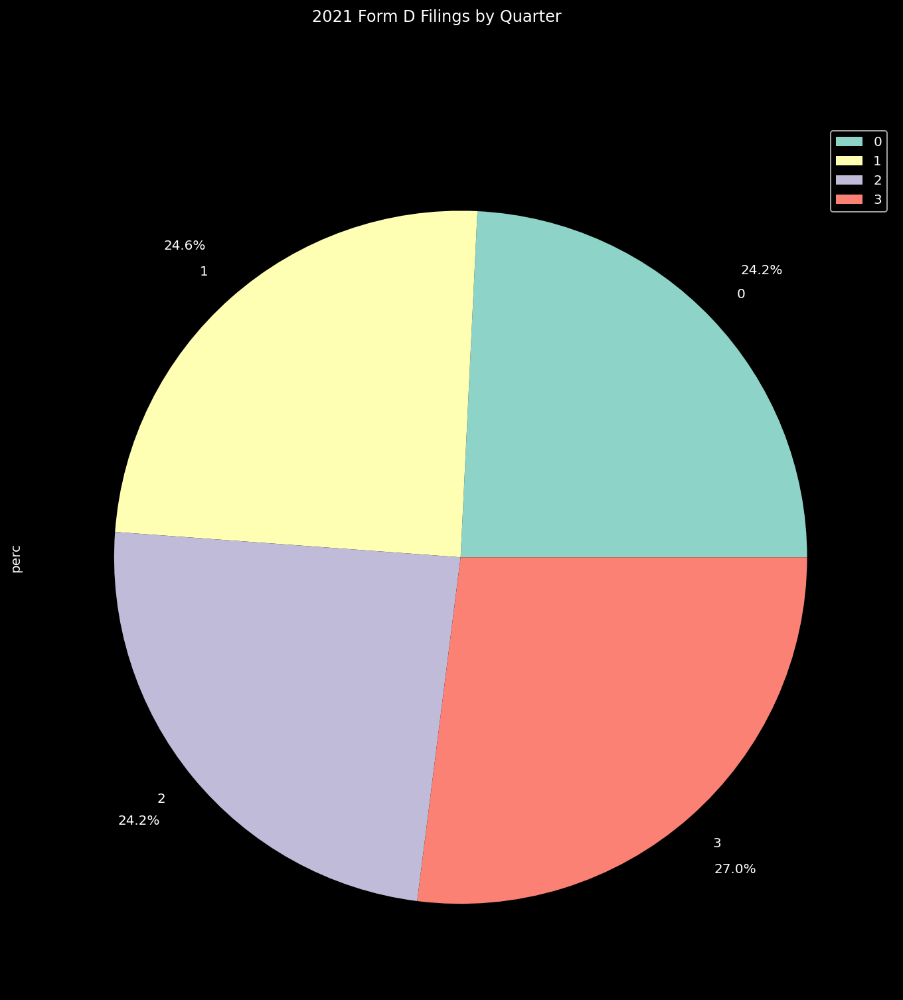

In [23]:
yq = cleaned.groupby(['year', 'quarter']).size().reset_index().rename(columns = { 0: 'filings' })
# Now get the percentage of each quarter for that year

yq['perc'] = yq['filings'] / yq.groupby('year')['filings'].transform('sum')

# Now make a pie chart for each year... I know there is a way to do this directly with a single pandas/plot line but I can't figure it out right now
yqy = yq.groupby('year')
yqyUnique = yqy.nunique().reset_index()
for row in yqyUnique.iterrows():
  year = row[1]['year']
  print(year)
  # Now we need to get everything for that year
  thisYear = yq.loc[yq['year'] == year].reset_index()
  print(thisYear)
  plot = thisYear.plot(kind='pie', y='perc', title='{} Form D Filings by Quarter'.format(year), subplots=True, autopct='%1.1f%%', pctdistance=1.2)

_show this by investor, see if VCs are filing more across the board where as HFs were doing in Q1_

Avg funding size by month over time

In [24]:
t1 = offerings[offerings['SALE_DATE'] > '2007']
t1 = t1[t1['SALE_DATE'] < '2023'].reset_index()
t2 = t1[t1['SALE_DATE'].notna()].sort_values('SALE_DATE')
t2['SALE_DATE'] = pd.to_datetime(t2['SALE_DATE'])
t3 = t2.set_index(pd.DatetimeIndex(t2["SALE_DATE"]))
t4 = t3.groupby([t3.index.year, t3.index.month])
t4 = t4.mean()['TOTALAMOUNTSOLD'].rename_axis(['year', 'month']).rename('sold').reset_index()
# formatted with the dash, it looks a lot nicer on x axis
t4['year month'] = t4['year'].astype(str) + '-' + t4['month'].astype(str)
print(t4)

def currency(x, pos):
  """The two args are the value and tick position"""
  if x >= 1e6:
      s = '${:1.1f}M'.format(x*1e-6)
  else:
      s = '${:1.0f}K'.format(x*1e-3)
  return s

# plot = t4.mean()['TOTALAMOUNTSOLD'].plot(logy=True)
# plot.set_xlabel('Sale date (Year, Month)')
# labels = plot.get_xticklabels()
# plt.setp(labels, 
#          rotation=45, 
#          horizontalalignment='right')
# plot.yaxis.set_major_formatter(currency)
fig = px.line(t4, x='year month', y='sold', title="Avg Total Amount Sold Per Offering", labels={
  "year month": "Date",
  "sold": "Private Securities Sold"
},  template='plotly_dark')
fig.write_html('total_amount_sold_avg.html')
fig.show()

     year  month          sold year month
0    2007      1  3.838529e+08     2007-1
1    2007      2  2.312332e+08     2007-2
2    2007      3  5.793818e+08     2007-3
3    2007      4  2.734494e+08     2007-4
4    2007      5  2.955560e+08     2007-5
..    ...    ...           ...        ...
178  2021     11  2.532946e+07    2021-11
179  2021     12  2.425176e+07    2021-12
180  2022      1  1.620130e+07     2022-1
181  2022      2  3.661160e+07     2022-2
182  2022      3  4.554854e+07     2022-3

[183 rows x 4 columns]


Look at that! The avg funding filing is actually _decreasing_

Now lets look at frequency on the monthly basis

In [25]:
f1 = offerings[offerings['SALE_DATE'] > '2007']
f1 = f1[f1['SALE_DATE'] < '2023'].reset_index()
f2 = f1[f1['SALE_DATE'].notna()].sort_values('SALE_DATE')
f2['SALE_DATE'] = pd.to_datetime(f2['SALE_DATE'])
# f2['SALE_DATE'] = f2['SALE_DATE'].dt.strftime("%Y-%m")
f3 = f2.set_index(pd.DatetimeIndex(f2["SALE_DATE"]))
f4 = f3.groupby([f3.index.year, f3.index.month]).size().rename_axis(['year', 'month']).rename('num').reset_index()
f4['year month'] = f4['year'].astype(str) + '-' + f4['month'].astype(str)
print(f4)
fig = px.line(f4, x='year month', y='num', title="Number of offerings per month", labels={
  "num": "Number of offerings",
  "year month": "Date"
},  template='plotly_dark')
fig.write_html('num_filings.html')
fig.show()

     year  month   num year month
0    2007      1  1224     2007-1
1    2007      2   667     2007-2
2    2007      3   635     2007-3
3    2007      4   863     2007-4
4    2007      5   629     2007-5
..    ...    ...   ...        ...
178  2021     11  3148    2021-11
179  2021     12  4112    2021-12
180  2022      1  3225     2022-1
181  2022      2  2383     2022-2
182  2022      3  1864     2022-3

[183 rows x 4 columns]


This adds a little more resolution to the previous chart. We can also see the COVID dip in early 2020. We can also see that while filings were way up in 2022, the number of offerings has actually come down! This is because filings can be done well after they have been offered.

I wonder if we can compare this to 2008 and realistically use this as a signal for an economic downturn?

Lets now look at who is investing in companies by month

In [26]:
i1 = offerings[offerings['SALE_DATE'] > '2007']
i1 = i1[i1['SALE_DATE'] < '2023'].reset_index()
i2 = i1[i1['SALE_DATE'].notna()].sort_values('SALE_DATE')

i2['year month'] = pd.DatetimeIndex(i2["SALE_DATE"]).strftime('%Y-%m')
i3 = i2.groupby(['year month', 'INVESTMENTFUNDTYPE']).size().rename('Filings').reset_index()
print(i3)
i4 = i3.pivot('year month', 'INVESTMENTFUNDTYPE', 'Filings')
# i4.to_csv('filings_by_fund_type.csv')
# plot = i4.plot()
# plot.set_xlabel('Sale date (Year, Month)')
# plot.set_ylabel('Number of filings')
fig = px.line(i4, title="Filings by Investment Fund Type", labels={
  "value": "Number of filings",
  "year month": "Date"
},  template='plotly_dark')
fig.write_html('num_filings_by_investment_fund_type.html')
fig.show()


    year month     INVESTMENTFUNDTYPE  Filings
0      2007-01             Hedge Fund      998
1      2007-01  Other Investment Fund      152
2      2007-01    Private Equity Fund        7
3      2007-01   Venture Capital Fund        2
4      2007-02             Hedge Fund      432
..         ...                    ...      ...
727    2022-02   Venture Capital Fund      744
728    2022-03             Hedge Fund       41
729    2022-03  Other Investment Fund      229
730    2022-03    Private Equity Fund      119
731    2022-03   Venture Capital Fund      613

[732 rows x 3 columns]


Interesting, lets do that as a normalized stacked area chart:

    year month     INVESTMENTFUNDTYPE  Filings
0      2007-01             Hedge Fund      998
1      2007-01  Other Investment Fund      152
2      2007-01    Private Equity Fund        7
3      2007-01   Venture Capital Fund        2
4      2007-02             Hedge Fund      432
..         ...                    ...      ...
727    2022-02   Venture Capital Fund      744
728    2022-03             Hedge Fund       41
729    2022-03  Other Investment Fund      229
730    2022-03    Private Equity Fund      119
731    2022-03   Venture Capital Fund      613

[732 rows x 3 columns]


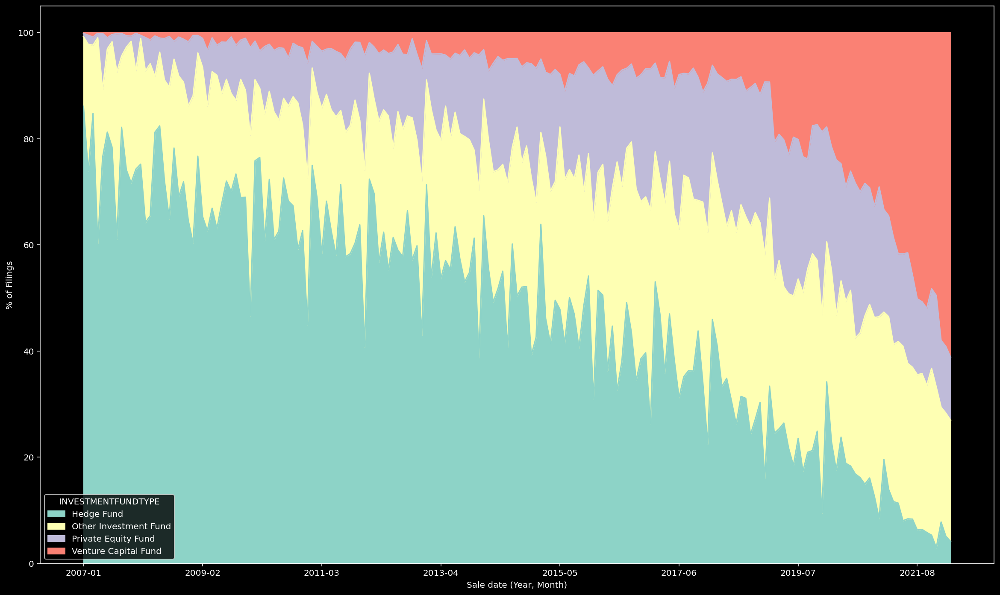

In [27]:
i1 = offerings[offerings['SALE_DATE'] > '2007']
i1 = i1[i1['SALE_DATE'] < '2023'].reset_index()
i2 = i1[i1['SALE_DATE'].notna()].sort_values('SALE_DATE')

i2['year month'] = pd.DatetimeIndex(i2["SALE_DATE"]).strftime('%Y-%m')
i3 = i2.groupby(['year month', 'INVESTMENTFUNDTYPE']).size().rename('Filings').reset_index()
print(i3)
i4 = i3.pivot('year month', 'INVESTMENTFUNDTYPE', 'Filings')
i4Perc = i4.divide(i4.sum(axis=1), axis=0) * 100
# i4Perc.to_csv('perc_filings_by_date_per_fund_type_as.csv')
plot = i4Perc.plot(kind='area')
plot.set_xlabel('Sale date (Year, Month)')
plot.set_ylabel('% of Filings')

fig = px.area(i4Perc, title="Investment share", labels={
  "value": "Percentage of filings",
  "year month": "Date"
},  template='plotly_dark')
fig.write_html('investment_share.html')
fig.show()

And let's also see the values of the rounds over time

In [28]:
ti1 = offerings[offerings['SALE_DATE'] > '2007']
ti1 = ti1[ti1['SALE_DATE'] < '2023'].reset_index()
ti2 = ti1[ti1['SALE_DATE'].notna()].sort_values('SALE_DATE')

ti2['year month'] = pd.DatetimeIndex(ti2["SALE_DATE"]).strftime('%Y-%m')
ti3 = ti2.groupby(['year month', 'INVESTMENTFUNDTYPE'])['TOTALAMOUNTSOLD'].median().rename('Round Size').reset_index()
ti4 = ti3.pivot('year month', 'INVESTMENTFUNDTYPE', 'Round Size')
# ti4.to_csv('round_size_med_by_fund.csv')
# plot = ti4.plot(kind='area')
# plot.set_xlabel('Sale date (Year, Month)')
# plot.yaxis.set_major_formatter(currency)
# # plot.set_ylim(0, 600000000)
# plot.set_ylabel('Round Size')
# plot.set_title('Round Size Median')

fig = px.area(ti4, title="Round size median", labels={
  "value": "Round Size",
  "year month": "Date"
},  template='plotly_dark')
fig.write_html('round_size_median.html')
fig.show()

Let's also look at a 5-day rolling average

In [29]:
i1 = offerings[offerings['SALE_DATE'] > '2007']
i1 = i1[i1['SALE_DATE'] < '2023']
i2 = i1[i1['SALE_DATE'].notna()].sort_values('SALE_DATE')

i2['year month'] = pd.DatetimeIndex(i2["SALE_DATE"]).strftime('%Y-%m-%d')
i3 = i2.groupby(['year month', 'INVESTMENTFUNDTYPE'])['TOTALAMOUNTSOLD'].mean().rename('Mean').reset_index()
i3['five_day_rolling'] = i3.rolling(5).mean()
i3 = i3.rename(columns={'five_day_rolling': 'Five Day Mean'})
print(i3)
i4 = i3.pivot('year month', 'INVESTMENTFUNDTYPE', 'Five Day Mean')
# plot = i4.plot(kind='area')
# plot.set_xlabel('Sale date (Year, Month)')
# plot.yaxis.set_major_formatter(currency)
# plot.set_ylim(0, 2000000000)
# plot.set_ylabel('Round Size, limited to 2B')
# plot.set_title('Round Size- 5 Day Rolling Average')

fig = px.area(i4, title="Round size 5-day rolling average", labels={
  "value": "Round size",
  "year month": "Date"
},  template='plotly_dark', range_y=[0, 2000000000])
fig.write_html('round_size_5_day_rolling_avg.html')
fig.show()

       year month     INVESTMENTFUNDTYPE          Mean  Five Day Mean
0      2007-01-01             Hedge Fund  4.531412e+08            NaN
1      2007-01-01  Other Investment Fund  1.770507e+08            NaN
2      2007-01-01   Venture Capital Fund  1.110289e+07            NaN
3      2007-01-02             Hedge Fund  3.174937e+08            NaN
4      2007-01-02  Other Investment Fund  4.905395e+08   2.898656e+08
...           ...                    ...           ...            ...
13492  2022-03-28   Venture Capital Fund  2.728520e+05   4.578309e+08
13493  2022-03-29  Other Investment Fund  3.113159e+05   2.452762e+07
13494  2022-03-29    Private Equity Fund  2.500000e+05   7.958836e+05
13495  2022-03-29   Venture Capital Fund  2.540020e+05   2.576340e+05
13496  2022-03-30  Other Investment Fund  4.596470e+05   3.095634e+05

[13497 rows x 4 columns]


As a whole, the industry is spending less on equity sales, VCs are spending more often, but generally less per round. However the variance between round sizes is still quite large, notably for VCs

Huh, let's narrow down to looking at the activity of venture capital funds

In [30]:
t1 = offerings[offerings['SALE_DATE'] > '2007']
t1 = t1[t1['SALE_DATE'] < '2023']
t2 = t1[t1['SALE_DATE'].notna()].sort_values('SALE_DATE')
t2 = t2[t2['INVESTMENTFUNDTYPE'] == 'Venture Capital Fund']
t2['SALE_DATE'] = pd.to_datetime(t2['SALE_DATE'])
t2['year month'] = pd.DatetimeIndex(t2["SALE_DATE"]).strftime('%Y-%m')
# unstack pivots the quantile grouping to their own columns
t3 = t2.groupby('year month')['TOTALAMOUNTSOLD'].quantile([0.3, 0.5, 0.9, 0.99]).unstack()
t3 = t3.rename(columns={ 0.50: 'median', 0.9: 'p90', 0.99: 'p99', 0.3: 'p30'})
print(t3)
# t3.to_csv('vc_round_size_by_date.csv')

# plot = t3.plot()
# plot.set_xlabel('Sale date (Year, Month)')
# plot.yaxis.set_major_formatter(currency)
# plot.set_ylabel('Round Size')
# plot = t3.plot(logy=True)
# plot.set_xlabel('Sale date (Year, Month)')
# plot.yaxis.set_major_formatter(currency)
# plot.set_ylabel('Round Size, Log Scale')

fig = px.line(t3, title="Round size percentiles over time", labels={
  "value": "Round size",
  "year month": "Date"
},  template='plotly_dark')
fig.write_html('vc_round_size_percentiles.html')
fig.show()

fig = px.line(t3, title="Round size percentiles over time", labels={
  "value": "Round size",
  "year month": "Date"
},  template='plotly_dark', log_y=True)
fig.write_html('vc_round_size_percentiles_log.html')
fig.show()

                   p30      median         p90           p99
year month                                                  
2007-01      8950637.5  11102894.5  15407408.5  1.637592e+07
2007-02      5000280.4   8167134.0  23531174.0  2.698808e+07
2007-03     34618035.2  79000000.0  95321584.0  1.051145e+08
2007-04      1250000.0   1250000.0   1250000.0  1.250000e+06
2007-05      4944622.0   4944622.0   4944622.0  4.944622e+06
...                ...         ...         ...           ...
2021-11       154000.0    323312.0  10000000.0  2.336952e+08
2021-12       159010.0    302742.5   7731091.1  3.344655e+08
2022-01       145150.0    302882.5   4302735.4  2.500860e+08
2022-02       125000.0    208033.0   5042402.3  4.041670e+08
2022-03       113800.0    205004.0   2887788.4  1.182566e+08

[183 rows x 4 columns]


What is that spike?

In [31]:
i1 = offerings[offerings['SALE_DATE'] > '2007']
i1 = i1[i1['SALE_DATE'] < '2023']
t2 = t1[t1['SALE_DATE'].notna()].sort_values('SALE_DATE')
t2 = t2[t2['INVESTMENTFUNDTYPE'] == 'Venture Capital Fund']
t2 = t2[t2['INVESTMENTFUNDTYPE'].notna()]
theSpike = t2[t2['TOTALAMOUNTSOLD'] == t2['TOTALAMOUNTSOLD'].max()].reset_index()
print("${:,.2f}".format(theSpike.at[0, 'TOTALAMOUNTSOLD']/100))

# Get their XML file
templateString = 'https://www.sec.gov/Archives/edgar/data/{}/{}/primary_doc.xml'
cik = issuersdf.loc[issuersdf['ACCESSIONNUMBER'] == theSpike.at[0, 'ACCESSIONNUMBER']].reset_index().at[0, 'CIK']
an = theSpike.at[0, 'ACCESSIONNUMBER']
firstURL = templateString.format(cik, an.replace('-', ''))
print(firstURL)
res = urllib.request.urlopen(firstURL)
xmlContent = res.read().decode()
print(xmlContent)

$258,460,382.36
https://www.sec.gov/Archives/edgar/data/1849988/000184998821000001/primary_doc.xml
<?xml version="1.0"?>
<edgarSubmission>

    <schemaVersion>X0708</schemaVersion>

    <submissionType>D</submissionType>

    <testOrLive>LIVE</testOrLive>

    <primaryIssuer>
        <cik>0001849988</cik>
        <entityName>OurCrowd (Investment in PCF 14) L.P.</entityName>
        <issuerAddress>
            <street1>28 DERECH HEBRON</street1>
            <city>JERUSALEM</city>
            <stateOrCountry>L3</stateOrCountry>
            <stateOrCountryDescription>ISRAEL</stateOrCountryDescription>
            <zipCode>9108001</zipCode>
        </issuerAddress>
        <issuerPhoneNumber>972-2-636-9300</issuerPhoneNumber>
        <jurisdictionOfInc>VIRGIN ISLANDS, BRITISH</jurisdictionOfInc>
        <issuerPreviousNameList>
            <value>None</value>
        </issuerPreviousNameList>
        <edgarPreviousNameList>
            <value>None</value>
        </edgarPreviousNameList>
 

Now let's if there there are more VCs popping up, or if VCs are investing more often

In [32]:
# Create a DF of just round and day
rd = offerings[offerings['SALE_DATE'] > '2007'].reset_index()
rd = rd[rd['SALE_DATE'] < '2023'].reset_index()
rd = rd[rd['INVESTMENTFUNDTYPE'] == 'Venture Capital Fund']
print(rd[['SALE_DATE', 'ACCESSIONNUMBER']].reset_index())

        index   SALE_DATE       ACCESSIONNUMBER
0         142  2011-03-18  0001516913-11-000001
1         234  2010-07-28  0001498414-11-000001
2         307  2011-03-16  0001516627-11-000001
3         308  2011-03-25  0001516628-11-000001
4         658  2011-03-08  0000897069-11-000242
...       ...         ...                   ...
21946  408104  2018-11-21  0001760709-20-000001
21947  408119  2019-12-31  0001798610-20-000002
21948  408125  2019-12-30  0001798556-20-000002
21949  408130  2019-12-31  0001798557-20-000002
21950  408229  2019-12-12  0001567619-20-000010

[21951 rows x 3 columns]


In [33]:
recipients = pd.DataFrame()

# Load data into memory
dirs = listdir(extractedPath)
rawDict = {}
for dir in dirs:
  year = dir.split('Q')[0]
  quarter = dir.split('Q')[1].split('_')[0]
  # open the tsv and get rows
  if path.exists('extracted/' + dir + '/RECIPIENTS.tsv'):
    newdat = pd.read_csv('extracted/' + dir + '/RECIPIENTS.tsv', sep='\t')
    # set the quarter and year
    newdat['year'] = year
    newdat['quarter'] = quarter
    recipients = pd.concat([recipients, newdat])
print(recipients)

           ACCESSIONNUMBER  RECIPIENT_SEQ_KEY            RECIPIENTNAME  \
0     0001517018-11-000001                101         Timothy Sullivan   
1     0001140361-11-019793                101  Canaccord Genuity Corp.   
2     0001517095-11-000001                101          A Plus Co., Ltd   
3     0000919574-11-002569                101  Global Emerging Markets   
4     0001145674-11-000001                101    PIMCO INVESTMENTS LLC   
...                    ...                ...                      ...   
9554  0001798500-20-000001                303         Patrick Whelchel   
9555  0001798500-20-000001                404           Scott Harrison   
9556  0001798500-20-000001                505           Charles Mathes   
9557  0001569476-20-000001                101                      NaN   
9558  0001683294-19-000003                101  Odeon Capital Group LLC   

     RECIPIENTCRDNUMBER                        ASSOCIATEDBDNAME  \
0               4505978                     

In [34]:
rPerRound = recipients[recipients['RECIPIENTNAME'].notna()]
rPerRound = rPerRound['ACCESSIONNUMBER'].value_counts().rename('num recipients').reset_index().rename(columns={'index': 'ACCESSIONNUMBER'})

# merge the number of recipients
rMerged = pd.merge(rd, rPerRound, 'left', 'ACCESSIONNUMBER')
rMerged = rMerged[rMerged['num recipients'].notna()]
rMerged = rMerged[['ACCESSIONNUMBER', 'num recipients', 'SALE_DATE']]
print(rMerged)

rGrp = rMerged.groupby('SALE_DATE').median().reset_index()
print(rGrp)
# plot = rGrp.plot(x='SALE_DATE')
fig = px.line(rGrp, x='SALE_DATE', y='num recipients', title="Number of Recipients per Round", labels={
  "num recipients": "Number of recipients",
  "SALE_DATE": "Sale Date"
},  template='plotly_dark')
fig.write_html('num_recipients_per_round.html')
fig.show()

            ACCESSIONNUMBER  num recipients   SALE_DATE
1      0001498414-11-000001             2.0  2010-07-28
2      0001516627-11-000001             1.0  2011-03-16
3      0001516628-11-000001             1.0  2011-03-25
7      0001510955-11-000005            46.0  2011-01-12
8      0001510954-11-000005            33.0  2011-01-19
...                     ...             ...         ...
21880  0001799697-20-000001             1.0  2020-01-08
21881  0001777614-20-000002             1.0  2019-06-11
21882  0001777614-20-000001             1.0  2019-05-16
21884  0001773446-20-000001             2.0  2019-04-05
21920  0001012975-20-000014            10.0  2019-12-20

[1692 rows x 3 columns]
      SALE_DATE  num recipients
0    2007-02-12            33.0
1    2007-02-14            30.0
2    2007-03-07            60.0
3    2007-03-09            40.0
4    2007-05-31            17.0
..          ...             ...
842  2022-03-14             1.0
843  2022-03-15             1.0
844  2022-03-17

OK so Vcs are not really investing more frequently... there must be more VCs?

In [35]:
# Admittedly I don't know how to do this in pandas
seenVCs = {}
datedVCSum = {}

rMerged = recipients[['ACCESSIONNUMBER', 'RECIPIENTNAME']]
rMerged = pd.merge(rd, rMerged, 'left', 'ACCESSIONNUMBER')
rMerged = rMerged[['SALE_DATE', 'ACCESSIONNUMBER', 'RECIPIENTNAME']]
rMerged = rMerged[rMerged['RECIPIENTNAME'].notna()]
rMerged = rMerged.sort_values('SALE_DATE')
# print(rMerged)
for row in rMerged.iterrows():
  r = row[1]
  if r['SALE_DATE'] not in datedVCSum:
    # new date
    datedVCSum[r['SALE_DATE']] = 0
  if r['RECIPIENTNAME'] not in seenVCs:
    # new VC
    datedVCSum[r['SALE_DATE']] += 1
    seenVCs[r['RECIPIENTNAME']] = True

# Turn into arrays
final = []
for row in datedVCSum.keys():
  final.append([row, datedVCSum[row]])
datedVCSum = pd.DataFrame(data=final, columns=["DATE", 'NUM_VCS'])
datedVCSum = datedVCSum.set_index(datedVCSum['DATE'])
datedVCSum = datedVCSum[['NUM_VCS']].cumsum()
print(datedVCSum)
# datedVCSum.plot(title='Total number of active VCs over time')
fig = px.line(datedVCSum, title="Total number of active VCs over time", labels={
  "value": "Cumulative number of VCs",
  "DATE": "Date"
}, template='plotly_dark')
fig.write_html('active_vcs.html')
fig.show()

            NUM_VCS
DATE               
2007-02-12       33
2007-02-14       39
2007-03-07       80
2007-03-09       93
2007-05-31       95
...             ...
2022-03-14      941
2022-03-15      941
2022-03-17      941
2022-03-22      941
2022-03-25      941

[847 rows x 1 columns]


So it seems like the number of VCs is growing, but round sizes aren't involving notably more investors

Lets look at where these companies are set up

In [36]:
jurs = issuersdf['JURISDICTIONOFINC'].reset_index().groupby('JURISDICTIONOFINC').size().rename('num').reset_index()
jurs = jurs[jurs['num'] > 2500]
print(jurs)

def label_function(val):
    return f'{val / 100 * len(df):.0f}\n{val:.0f}%'

# plot = jurs.plot(kind='pie', autopct=label_function, title='Corporations by Jurisdiction of Inc.')
fig = px.pie(jurs, names='JURISDICTIONOFINC', values='num', template='plotly_dark')
fig.write_html('jurisdiction_pie.html')
fig.show()

            JURISDICTIONOFINC     num
28   BRITISH COLUMBIA, CANADA    5747
35                 CALIFORNIA   14299
37             CAYMAN ISLANDS   54078
41                   COLORADO    5375
52                         DE    4265
53                   DELAWARE  307948
64                    FLORIDA    6362
68                    GEORGIA    3999
88                   ILLINOIS    3583
114                LUXEMBOURG    2679
122                  MARYLAND    3550
148                    NEVADA    9084
153                  NEW YORK    6498
159            NORTH CAROLINA    2945
168                      OHIO    6749
172           ONTARIO, CANADA    2702
180              PENNSYLVANIA    3715
208                     TEXAS   17991
228   VIRGIN ISLANDS, BRITISH    3998
230                  VIRGINIA    2704
233                WASHINGTON    5544


I don't think anyone is surprised by Delaware, but I am a bit by cayman islands and texas

Now let's look at the filings for entity types over time

In [37]:
ent = issuersdf[['ACCESSIONNUMBER', 'ENTITYTYPE']]
sales = offerings[['ACCESSIONNUMBER', 'SALE_DATE']]
merged = pd.merge(ent, sales, 'left', 'ACCESSIONNUMBER')
merged = merged[merged['SALE_DATE'].notna()]
merged = merged[merged['SALE_DATE'] > '2008']
merged = merged[merged['SALE_DATE'] <= '2022']
merged = merged[['ENTITYTYPE', 'SALE_DATE']]
merged = merged.sort_values('SALE_DATE')
merged = merged.groupby(['SALE_DATE', 'ENTITYTYPE']).size().rename('num ents').reset_index()
print(merged)
merged['cum sum ents'] = merged.groupby(['ENTITYTYPE'])['num ents'].cumsum()
# merged = merged.pivot(index='SALE_DATE', columns='ENTITYTYPE', values='cum sum ents')
fig = px.line(merged, x='SALE_DATE', y='cum sum ents', color='ENTITYTYPE', title="Cumulative number of entities by type over time", labels={
  "sum sum ents": "Cumulative number of entities",
  "SALE_DATE": "Sale Date"
},  template='plotly_dark')
fig.write_html('cum_num_ent_type.html')
fig.show()

        SALE_DATE                 ENTITYTYPE  num ents
0      2008-01-01                Corporation       105
1      2008-01-01  Limited Liability Company       108
2      2008-01-01        Limited Partnership       580
3      2008-01-01                      Other       277
4      2008-01-02                Corporation        15
...           ...                        ...       ...
17298  2021-12-31                Corporation        52
17299  2021-12-31        General Partnership         3
17300  2021-12-31  Limited Liability Company       108
17301  2021-12-31        Limited Partnership        48
17302  2021-12-31                      Other         4

[17303 rows x 3 columns]


Corporations are dominants, while LLCs are gaining popularity fast.

Now lets look at how many rounds companies do

In [38]:
rounds = issuersdf[['ACCESSIONNUMBER', 'CIK', 'ENTITYNAME']]
grp = rounds.groupby('CIK').size().rename('num rounds').reset_index()
# print(grp)
grp.loc[grp['num rounds'] > 7, 'num rounds'] = '8+'
grp = grp.groupby('num rounds').size().rename('num round count').reset_index()
grp['num rounds'] = grp['num rounds'].astype(str)
print(grp)

# Plot with plotly because matplotlib doesn't do funnel charts well
import plotly.express as px
fig = px.funnel(grp, x='num round count', y='num rounds', title='Number of filings', template='plotly_dark', labels={
  "num rounds": "Filings"
})
fig.write_html('funnel_number_rounds_raised.html')
fig.show()

  num rounds  num round count
0          1           155786
1          2            37538
2          3            15960
3          4             8896
4          5             5855
5          6             4118
6          7             2996
7         8+            11578


Relatively few companies make it to future funding rounds. Lets look at first raises over time:

In [39]:
rounds = issuersdf[['ACCESSIONNUMBER', 'CIK', 'year', 'quarter']]
rounds['yq'] = rounds['year'] + ' Q' + rounds['quarter']
grp = rounds.groupby('CIK').size().rename('total rounds').reset_index()
grp.loc[grp['total rounds'] > 5, 'total rounds'] = '6+'
grp = pd.merge(rounds, grp, 'left', 'CIK')
grp = grp.groupby(['yq', 'total rounds']).size().rename('cum filings').reset_index()
grp = grp.pivot(index='yq', columns='total rounds', values='cum filings')
fig = px.line(grp, title="How many companies have filed X times in total over time", labels={
  "value": "Number of rounds raised",
  "yq": "Date"
},  template='plotly_dark')
fig.update_xaxes(
  tickvals=['2008 Q1', '2009 Q1', '2010 Q1', '2011 Q1', '2012 Q1', '2013 Q1', '2014 Q1', '2015 Q1', '2016 Q1', '2017 Q1', '2018 Q1', '2019 Q1', '2020 Q1', '2021 Q1', '2022 Q1']
)
fig.write_html('company_filings_x_times.html')
fig.show()

<ipython-input-39-bbe3be5e1add>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



So companies that have raised one round raises are rapidly increasing over time, with second and third rounds being distant second and third places, could this indicate that many of these companies are getting acquired, only need one round, or just have only raised one round so far?

It does show the number of companies raising their first round (or selling) has dramatically increased in 2021 and 2022.

A lot of companies are popping up that are exiting or raising money over the last 2 years.
Any exits here would be bootstrapped exists most likely.

Now let's look at by each raise stage over time, and see what round each raise represents

In [40]:
rounds = issuersdf[['ACCESSIONNUMBER', 'CIK', 'year', 'quarter']]
rounds['yq'] = rounds['year'] + ' Q' + rounds['quarter']
rounds['round number'] = rounds.groupby('CIK').cumcount() + 1
rounds.loc[rounds['round number'] > 5, 'round number'] = '6+'
rounds = rounds.groupby(['yq', 'round number']).size().rename('total filings').reset_index()
rounds = rounds.pivot(index='yq', columns='round number', values='total filings')
# rounds.to_csv('round_num_at_raise.csv')
fig = px.line(rounds, title="Round number at raise over time", labels={
  "value": "Number of rounds raised",
  "yq": "Date"
},  template='plotly_dark')
fig.update_xaxes(
  tickvals=['2008 Q1', '2009 Q1', '2010 Q1', '2011 Q1', '2012 Q1', '2013 Q1', '2014 Q1', '2015 Q1', '2016 Q1', '2017 Q1', '2018 Q1', '2019 Q1', '2020 Q1', '2021 Q1', '2022 Q1']
)
fig.write_html('round_num_at_raise.html')
fig.show()

<ipython-input-40-f6b227786ca6>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-40-f6b227786ca6>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.9/site-packages/pandas/core/indexing.py:1720: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus

This tells us that most filings during a quarter are first round filings, but the number of second round filings does not increase much.

Now lets see investor activity over time

In [41]:
vcs = recipients[recipients['year'] > '2007'].reset_index()
vcs = vcs[vcs['year'] < '2023'].reset_index()
print(vcs)
vcs = pd.merge(vcs, offerings, 'left', 'ACCESSIONNUMBER')
vcs = vcs[['SALE_DATE', 'RECIPIENTNAME']]
vcs = vcs.groupby(['SALE_DATE', 'RECIPIENTNAME']).size().rename('num invs').reset_index()
vcCount = vcs.groupby(['RECIPIENTNAME']).size().rename('total invs').reset_index()
vcCount = vcCount[vcCount['total invs'] > 50]
removedVCS = ['None', 'none', '(None)', '(none)', '*', '-', '--', '.', '0', '000', 'na', 'xxxxxxxxxx', 'NONE']
vcCount = vcCount[~vcCount['RECIPIENTNAME'].isin(removedVCS)] # is not in
print(vcCount)
vcs = vcs[~vcs['RECIPIENTNAME'].isin(removedVCS)] # is not in
vcs = vcs[vcs['SALE_DATE'] > '2007']
vcs = pd.merge(vcs, vcCount, 'left', 'RECIPIENTNAME')
vcs = vcs[vcs['total invs'].notna()] # yes I know this is done already and could be done more efficiently I don't care
vcs['cs invs'] = vcs.groupby(['RECIPIENTNAME'])['num invs'].cumsum()
vcs = vcs.pivot(index = 'SALE_DATE', columns='RECIPIENTNAME', values='cs invs')
print(vcs)
fig = px.line(vcs, labels={
  "SALE_DATE": "Date",
  "value": "Cumulative investments"
}, template='plotly_dark')
fig.write_html('investor_activity_over_time.html')
fig.show()

        level_0  index       ACCESSIONNUMBER  RECIPIENT_SEQ_KEY  \
0             0      0  0001517018-11-000001                101   
1             1      1  0001140361-11-019793                101   
2             2      2  0001517095-11-000001                101   
3             3      3  0000919574-11-002569                101   
4             4      4  0001145674-11-000001                101   
...         ...    ...                   ...                ...   
309531   309531   9554  0001798500-20-000001                303   
309532   309532   9555  0001798500-20-000001                404   
309533   309533   9556  0001798500-20-000001                505   
309534   309534   9557  0001569476-20-000001                101   
309535   309535   9558  0001683294-19-000003                101   

                  RECIPIENTNAME RECIPIENTCRDNUMBER  \
0              Timothy Sullivan            4505978   
1       Canaccord Genuity Corp.               None   
2               A Plus Co., Ltd  

Huh, let's zoom in and see who that one very active line is

In [43]:
vcs = recipients[recipients['year'] > '2007'].reset_index()
vcs = vcs[vcs['year'] < '2023'].reset_index()
vcs = pd.merge(vcs, offerings, 'left', 'ACCESSIONNUMBER')
vcs = vcs[['SALE_DATE', 'RECIPIENTNAME']]
vcs = vcs.groupby(['SALE_DATE', 'RECIPIENTNAME']).size().rename('num invs').reset_index()
vcCount = vcs.groupby(['RECIPIENTNAME']).size().rename('total invs').reset_index()
vcCount = vcCount[vcCount['total invs'] > 250]
removedVCS = ['None', 'none', '(None)', '(none)', '*', '-', '--', '.', '0', '000', 'na', 'xxxxxxxxxx', 'NONE']
vcCount = vcCount[~vcCount['RECIPIENTNAME'].isin(removedVCS)] # is not in
print(vcCount)
vcs = vcs[~vcs['RECIPIENTNAME'].isin(removedVCS)] # is not in
vcs = vcs[vcs['SALE_DATE'] > '2007']
vcs = pd.merge(vcs, vcCount, 'left', 'RECIPIENTNAME')
vcs = vcs[vcs['total invs'].notna()] # yes I know this is done already and could be done more efficiently I don't care
vcs['cs invs'] = vcs.groupby(['RECIPIENTNAME'])['num invs'].cumsum()
print(vcs)
vcs = vcs.pivot(index = 'SALE_DATE', columns='RECIPIENTNAME', values='cs invs')
fig = px.line(vcs, template='plotly_dark', labels={
  "SALE_DATE": "Date",
  "value": "Cumulative investments"
})
fig.write_html('investor_activity_over_time_top.html')
fig.show()

                                           RECIPIENTNAME  total invs
5382                  Credit Suisse Securities (USA) LLC         255
7822                            EquityZen Securities LLC         672
9596                             Goldman Sachs & Co. LLC         311
9606                                Goldman, Sachs & Co.         281
11168                         J.P. Morgan Securities LLC         319
15320                                      Lori Mayfield         277
16817  Merrill Lynch, Pierce, Fenner & Smith Incorpor...         332
17723                    Morgan Stanley Smith Barney LLC         316
22499                                     Scott Harrison         287
        SALE_DATE                                      RECIPIENTNAME  \
12     2007-01-01                 Credit Suisse Securities (USA) LLC   
22     2007-01-01                            Goldman Sachs & Co. LLC   
23     2007-01-01                               Goldman, Sachs & Co.   
41     2007-01-01  Mer

EquityZen Securities LLC. They are an online platform for "Pre-IPO Equity". Basically connecting buyers and companies.
Also it seems for the most part the largest players are backing off.
Scott Harrison is "Portfolio Manager at Verition Fund Management LLC"
Lori Mayfield is "CFO at REIT Funding" maybe...

Let's look at the trends by industry now

In [44]:
# Load in the industry
industries = pd.read_csv('industrygroups.csv')
temp = offerings
temp['ACCESSIONNUMBER'] = temp['ACCESSIONNUMBER'].astype(str).apply(lambda x: x.replace('-', '')).astype(int)
print(temp)
print(industries)

       ACCESSIONNUMBER       INDUSTRYGROUPTYPE     INVESTMENTFUNDTYPE IS40ACT  \
0      151701811000001  Pooled Investment Fund    Private Equity Fund   False   
1      114036111019793                   Other                    NaN     NaN   
2      151598211000002                   Other                    NaN     NaN   
3      137387511000001  Pooled Investment Fund             Hedge Fund   False   
4      145298711000001        Other Technology                    NaN     NaN   
...                ...                     ...                    ...     ...   
12698  179854919000001             Agriculture                    NaN     NaN   
12699  179420319000015  Pooled Investment Fund  Other Investment Fund   False   
12700  179420319000016  Pooled Investment Fund  Other Investment Fund   False   
12701  178783619000001  Pooled Investment Fund             Hedge Fund   False   
12702  168329419000003       Other Health Care                    NaN     NaN   

                  REVENUERA

In [48]:

merged = pd.merge(temp, industries, 'left', 'ACCESSIONNUMBER')
merged = merged[['ACCESSIONNUMBER', 'CIK', 'Industry Group', 'year', 'quarter']]
merged['yq'] = merged['year'] + ' Q' + merged['quarter']
merged = merged[['ACCESSIONNUMBER', 'CIK', 'Industry Group', 'yq']]
merged = merged[merged['CIK'].notna()]
merged = merged[merged['Industry Group'].notna()]
merged = merged.groupby(['yq', 'Industry Group']).size().rename('num filings').reset_index()
merged = merged.pivot(index='yq', columns='Industry Group', values='num filings')
print(merged)
fig = px.line(merged, title='Num filings by industry group per quarter', template='plotly_dark', labels={
  "value": "Number of filings",
  "yq": "Date"
})
fig.write_html('filings_per_industry_group.html')
fig.show()

Industry Group  Agriculture  Airlines and Airports  Biotechnology  \
yq                                                                  
2017 Q1                39.0                    5.0          236.0   
2017 Q2                50.0                    3.0          251.0   
2017 Q3                46.0                    1.0          243.0   
2017 Q4                34.0                    1.0          191.0   
2018 Q1                43.0                    NaN          241.0   
2018 Q2                42.0                    1.0          238.0   
2018 Q3                62.0                    NaN          229.0   
2018 Q4                55.0                    NaN          209.0   
2019 Q1                48.0                    1.0          205.0   
2019 Q2                80.0                    1.0          219.0   
2019 Q3                62.0                    3.0          237.0   
2019 Q4                59.0                    2.0          247.0   
2020 Q2                57.0       

It looks like "Pooled Investment Funds" are taking over, but let's remove that to see what the reset looks like

In [49]:
merged = pd.merge(temp, industries, 'left', 'ACCESSIONNUMBER')
merged = merged[['ACCESSIONNUMBER', 'CIK', 'Industry Group', 'year', 'quarter']]
merged['yq'] = merged['year'] + ' Q' + merged['quarter']
merged = merged[['ACCESSIONNUMBER', 'CIK', 'Industry Group', 'yq']]
merged = merged[merged['CIK'].notna()]
merged = merged[merged['Industry Group'].notna()]
merged = merged[merged['Industry Group'] != "Pooled Investment Fund"]
merged = merged.groupby(['yq', 'Industry Group']).size().rename('num filings').reset_index()
merged = merged.pivot(index='yq', columns='Industry Group', values='num filings')
# merged.to_csv('filings_per_industry_group_no_pool.csv')
print(merged)
fig = px.line(merged, title='Num filings by industry group per quarter', template='plotly_dark', labels={
  "value": "Number of filings",
  "yq": "Date"
})
fig.write_html('filings_per_industry_group_no_pool.html')
fig.show()

Industry Group  Agriculture  Airlines and Airports  Biotechnology  \
yq                                                                  
2017 Q1                39.0                    5.0          236.0   
2017 Q2                50.0                    3.0          251.0   
2017 Q3                46.0                    1.0          243.0   
2017 Q4                34.0                    1.0          191.0   
2018 Q1                43.0                    NaN          241.0   
2018 Q2                42.0                    1.0          238.0   
2018 Q3                62.0                    NaN          229.0   
2018 Q4                55.0                    NaN          209.0   
2019 Q1                48.0                    1.0          205.0   
2019 Q2                80.0                    1.0          219.0   
2019 Q3                62.0                    3.0          237.0   
2019 Q4                59.0                    2.0          247.0   
2020 Q2                57.0       

So "Other" and "Other Technology" dominate, but the pink is growing fast, that's "REITs and Finance". Maybe that explains Lori from REIT Funding.
What's also interesting is that technology is not increasing that fast in the last few years

Let's also check the size of these rounds by industry group as well

In [52]:
merged = pd.merge(temp, industries, 'left', 'ACCESSIONNUMBER')
merged = merged[['ACCESSIONNUMBER', 'CIK', 'Industry Group', 'year', 'quarter', 'TOTALAMOUNTSOLD']]
merged['yq'] = merged['year'] + ' Q' + merged['quarter']
merged = merged[['ACCESSIONNUMBER', 'CIK', 'Industry Group', 'yq', 'TOTALAMOUNTSOLD']]
merged = merged[merged['CIK'].notna()]
merged = merged[merged['Industry Group'].notna()]
merged = merged[merged['Industry Group'] != "Pooled Investment Fund"]
merged = merged.groupby(['yq', 'Industry Group'])['TOTALAMOUNTSOLD'].sum().reset_index()
print(merged)
merged = merged.pivot(index='yq', columns='Industry Group', values='TOTALAMOUNTSOLD')
fig = px.line(merged, title='Total investments by industry group per quarter', template='plotly_dark', labels={
  "value": "Total investments",
  "yq": "Date"
})
fig.write_html('total_raised_by_industry_group.html')
fig.show()

          yq               Industry Group  TOTALAMOUNTSOLD
0    2017 Q1                  Agriculture         80779005
1    2017 Q1        Airlines and Airports         10262995
2    2017 Q1                Biotechnology       3572606460
3    2017 Q1            Business Services        210767124
4    2017 Q1                   Commercial       1591973851
..       ...                          ...              ...
664  2022 Q1                  Residential       3168138492
665  2022 Q1                  Restaurants        431199617
666  2022 Q1                    Retailing        395793913
667  2022 Q1           Telecommunications        611684518
668  2022 Q1  Tourism and Travel Services          8971900

[669 rows x 3 columns]


So insurance is by far raising the most per quarter, with REITs coming up fast as well.
Other technology has come down the last few quarters.

If we isolate "Other Technology", we see a similar shape to number of investments.

In [53]:
merged = pd.merge(temp, industries, 'left', 'ACCESSIONNUMBER')
merged = merged[['ACCESSIONNUMBER', 'CIK', 'Industry Group', 'year', 'quarter', 'TOTALAMOUNTSOLD']]
merged['yq'] = merged['year'] + ' Q' + merged['quarter']
merged = merged[['ACCESSIONNUMBER', 'CIK', 'Industry Group', 'yq', 'TOTALAMOUNTSOLD']]
merged = merged[merged['CIK'].notna()]
merged = merged[merged['Industry Group'].notna()]
merged = merged[merged['Industry Group'] == "Other Technology"]
merged = merged.groupby(['yq', 'Industry Group'])['TOTALAMOUNTSOLD'].sum().reset_index()
print(merged)
merged = merged.pivot(index='yq', columns='Industry Group', values='TOTALAMOUNTSOLD')
fig = px.line(merged, title='Total investments by industry group per quarter', template='plotly_dark', labels={
  "value": "Total investments",
  "yq": "Date"
})
fig.write_html('total_raised_by_industry_group_technology.html')
fig.show()

         yq    Industry Group  TOTALAMOUNTSOLD
0   2017 Q1  Other Technology       6396100726
1   2017 Q2  Other Technology       6015180899
2   2017 Q3  Other Technology       6305029271
3   2017 Q4  Other Technology       6456455423
4   2018 Q1  Other Technology      10161379669
5   2018 Q2  Other Technology       8556283219
6   2018 Q3  Other Technology       9225359864
7   2018 Q4  Other Technology      10718052466
8   2019 Q1  Other Technology       9286373469
9   2019 Q2  Other Technology      12142098329
10  2019 Q3  Other Technology       9388572105
11  2019 Q4  Other Technology      10453762750
12  2020 Q2  Other Technology       9731694706
13  2020 Q3  Other Technology      14355957932
14  2020 Q4  Other Technology      22465691887
15  2021 Q1  Other Technology      33467494395
16  2021 Q2  Other Technology      27869940603
17  2021 Q3  Other Technology      27805581478
18  2021 Q4  Other Technology      24964937401
19  2022 Q1  Other Technology      19285525915
